##Stereo Vision-based Depth Map & ML-based Object Recognition using OpenCV

* Build a stereo pair with a couple of smartphones/webcams (switching off the autofocusing mode), and calibrate it using a checkerboard & OpenCV Python. When recording the images, use static poses of the checkerboard.

* Place yourself (and other guys) in a scene in front of the stereo pair, and take an image dataset (from left & right cameras).

* Detect humans using YOLOv5, OpenCV Python and the images from one of the camera

* Estimate the distance to the humans in the image using the depth information.

In [1]:
import numpy as np
import cv2
from glob import glob
import matplotlib.pyplot as plt
from tqdm import tqdm



#Cameras Calibration:

In [ ]:
# function to read and resize an image
def read_and_resize(filename: str, grayscale: bool = False, fx: float = 1.0, fy: float = 1.0):
    if grayscale:
      img_result = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    else:
      imgbgr = cv2.imread(filename, cv2.IMREAD_COLOR)
      # convert to rgb
      img_result = cv2.cvtColor(imgbgr, cv2.COLOR_BGR2RGB)
    # resize
    if fx != 1.0 and fy != 1.0:
      img_result = cv2.resize(img_result, None, fx=fx, fy=fy, interpolation = cv2.INTER_CUBIC)
    return img_result

    
def show_in_row(list_of_images: list, titles: list = None, disable_ticks: bool = False):
  count = len(list_of_images)
  for idx in range(count):
    subplot = plt.subplot(1, count, idx+1)
    if titles is not None:
      subplot.set_title(titles[idx])
      
    img = list_of_images[idx]
    cmap = 'gray' if (len(img.shape) == 2 or img.shape[2] == 1) else None
    subplot.imshow(img, cmap=cmap)
    if disable_ticks:
      plt.xticks([]), plt.yticks([])
  plt.show()

In [ ]:
from google.colab.patches import cv2_imshow

pattern_size = (26, 18)
square_size = 11

pattern_points = np.zeros((np.prod(pattern_size), 3), np.float32)
pattern_points[:, :2] = np.indices(pattern_size).T.reshape(-1, 2)
pattern_points *= square_size
obj_points = []
img_points = []



  0%|          | 0/20 [00:00<?, ?it/s]

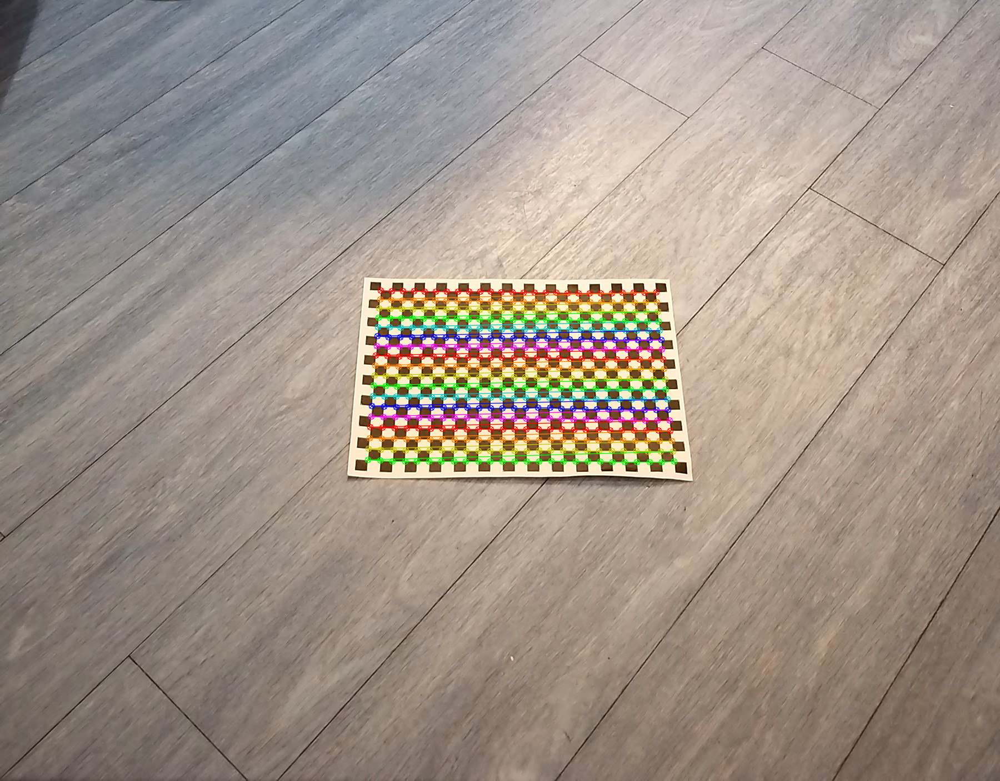

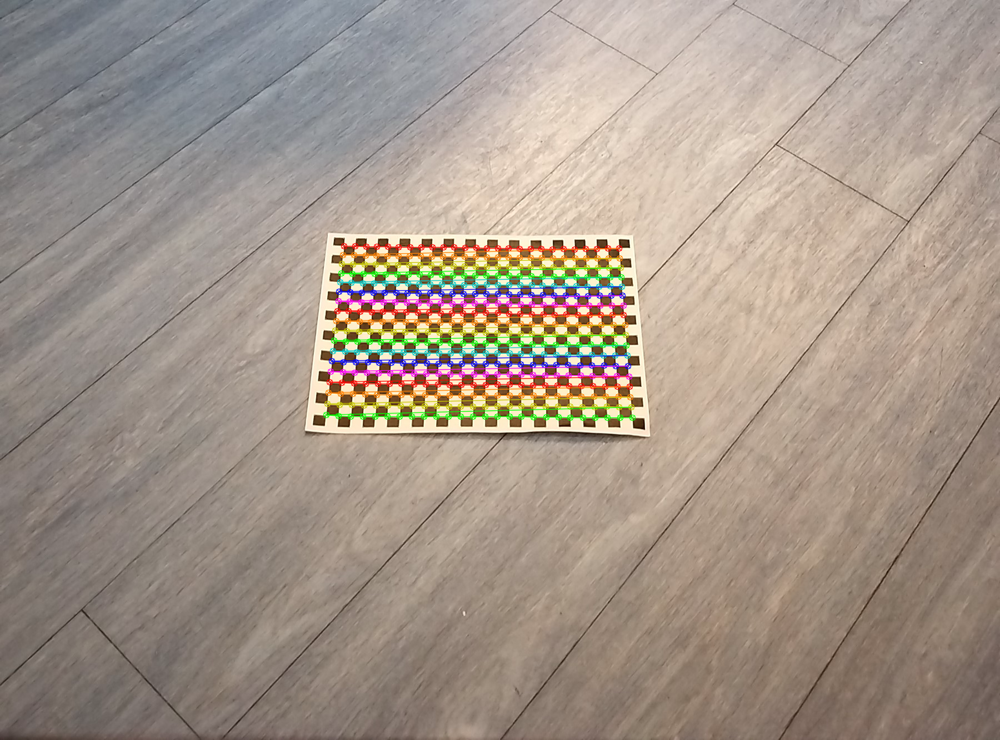

  5%|▌         | 1/20 [00:02<00:39,  2.07s/it]

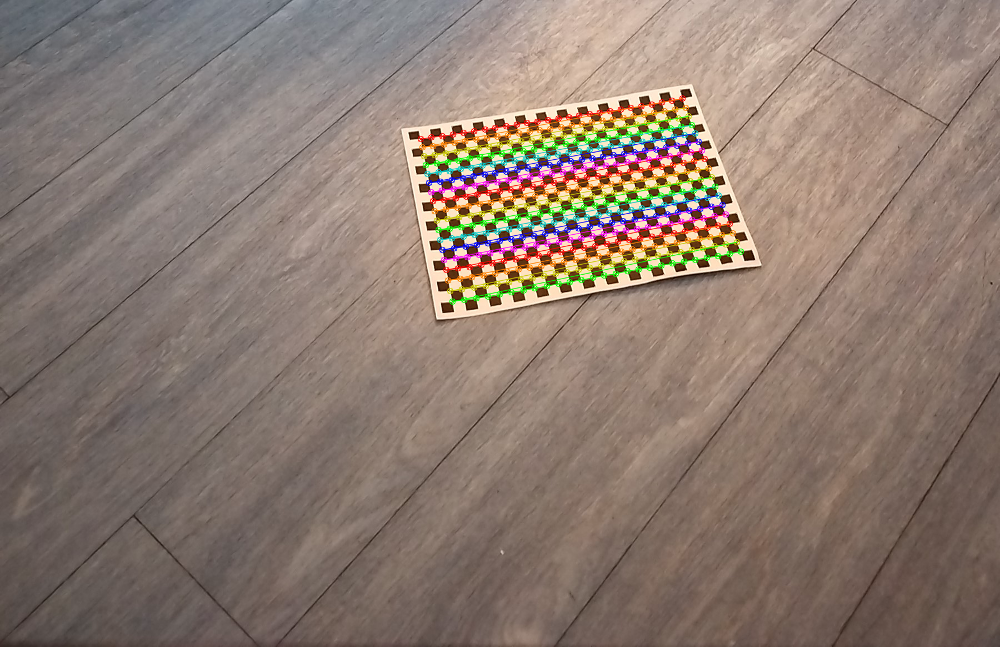

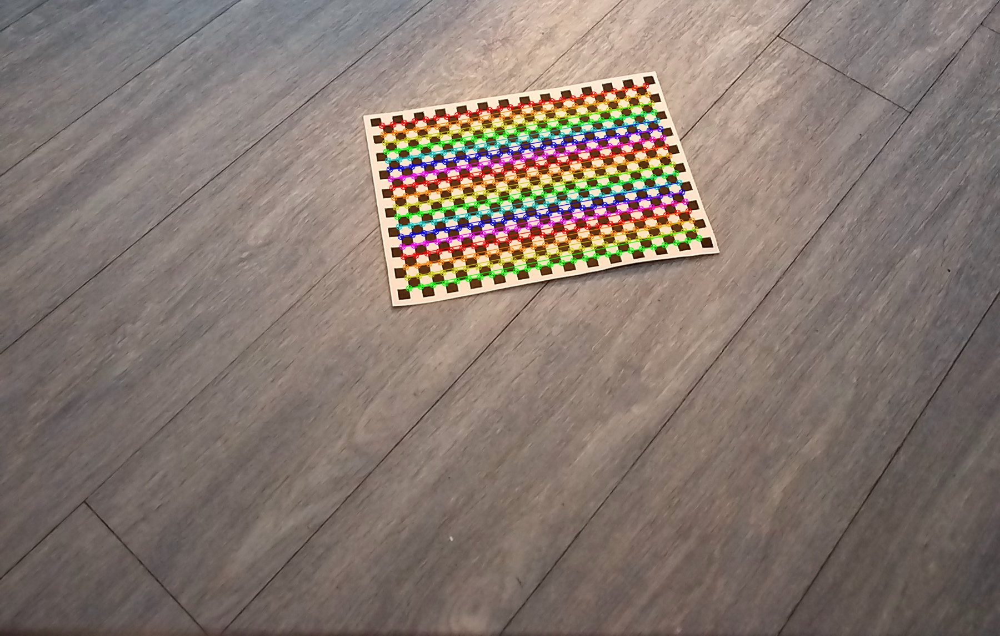

 10%|█         | 2/20 [00:03<00:34,  1.92s/it]

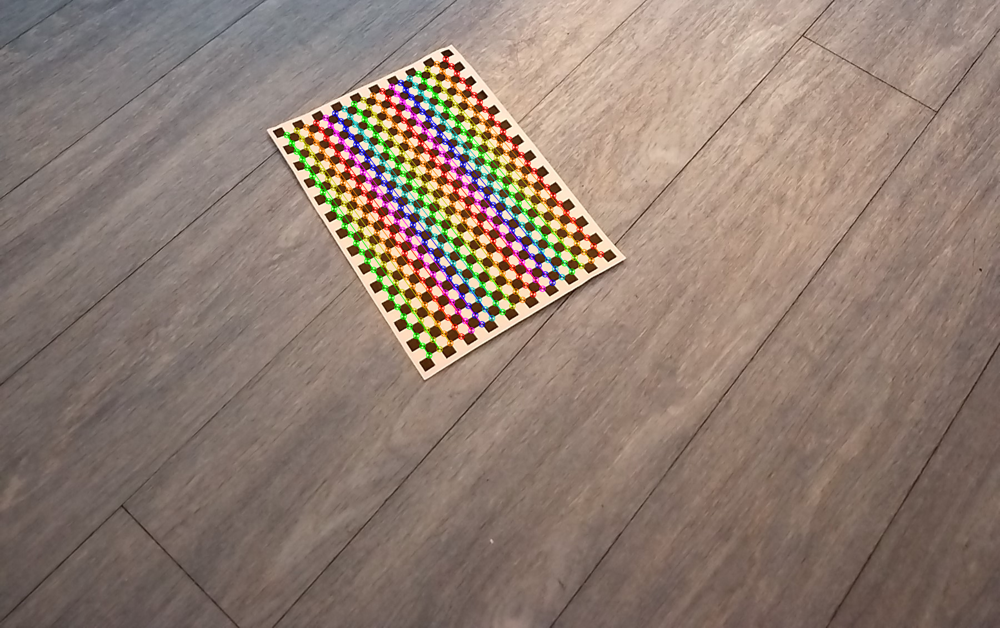

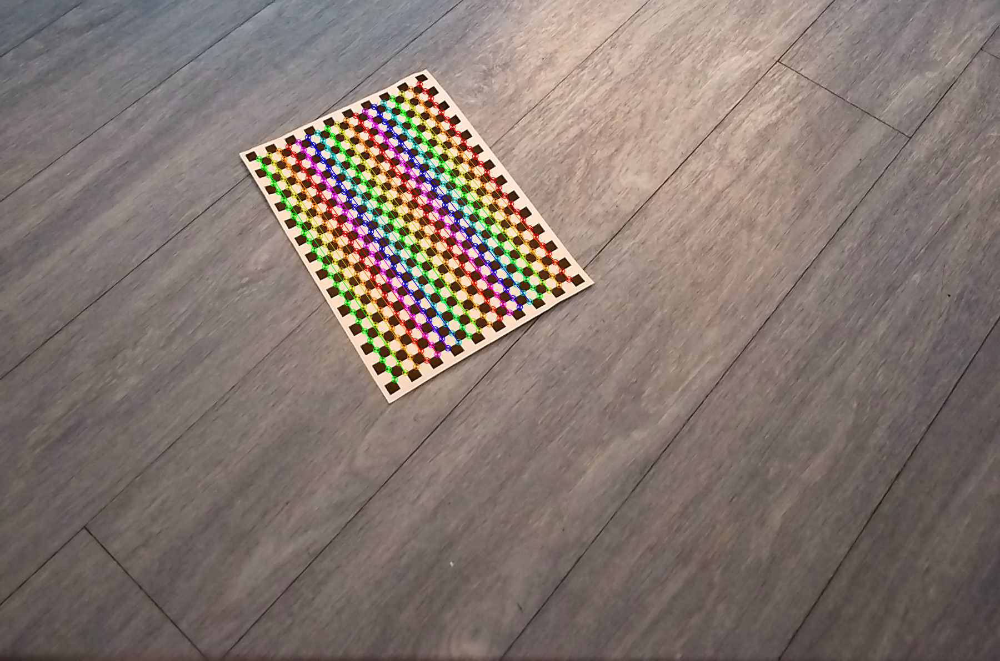

 15%|█▌        | 3/20 [00:06<00:38,  2.24s/it]

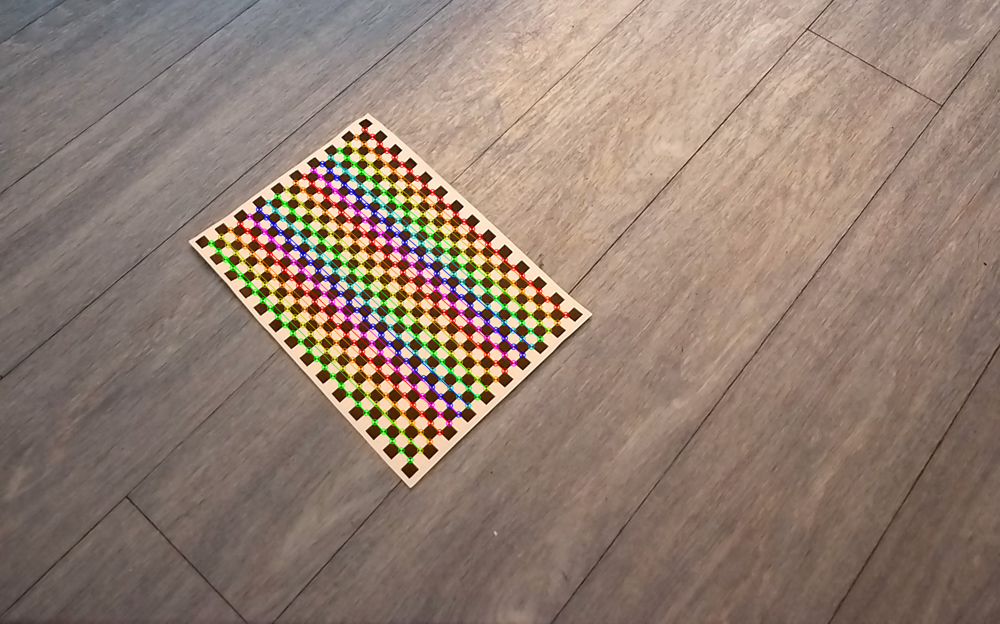

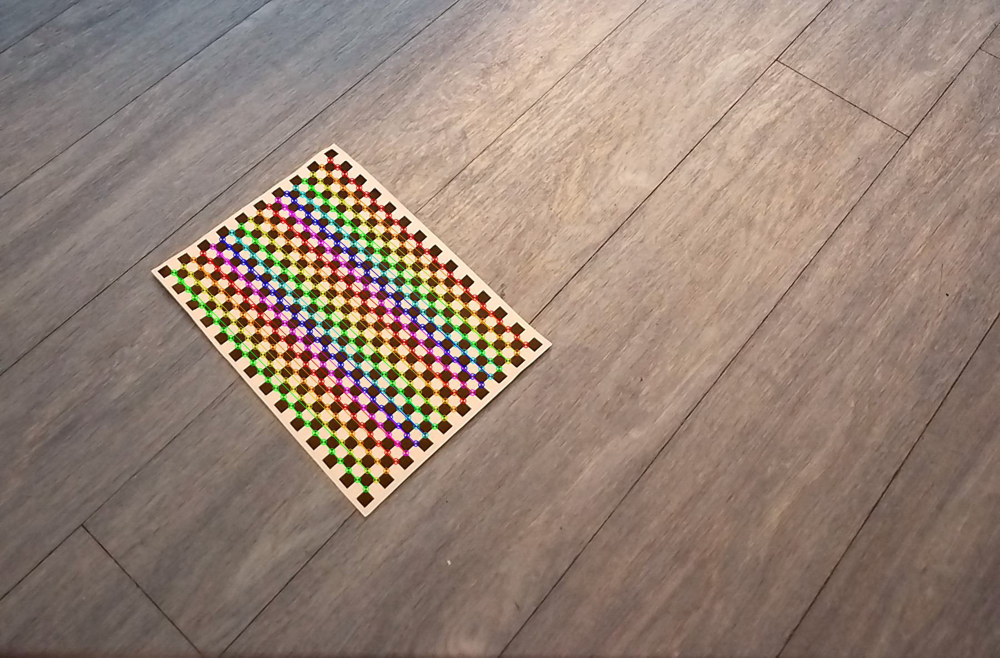

 20%|██        | 4/20 [00:09<00:38,  2.39s/it]

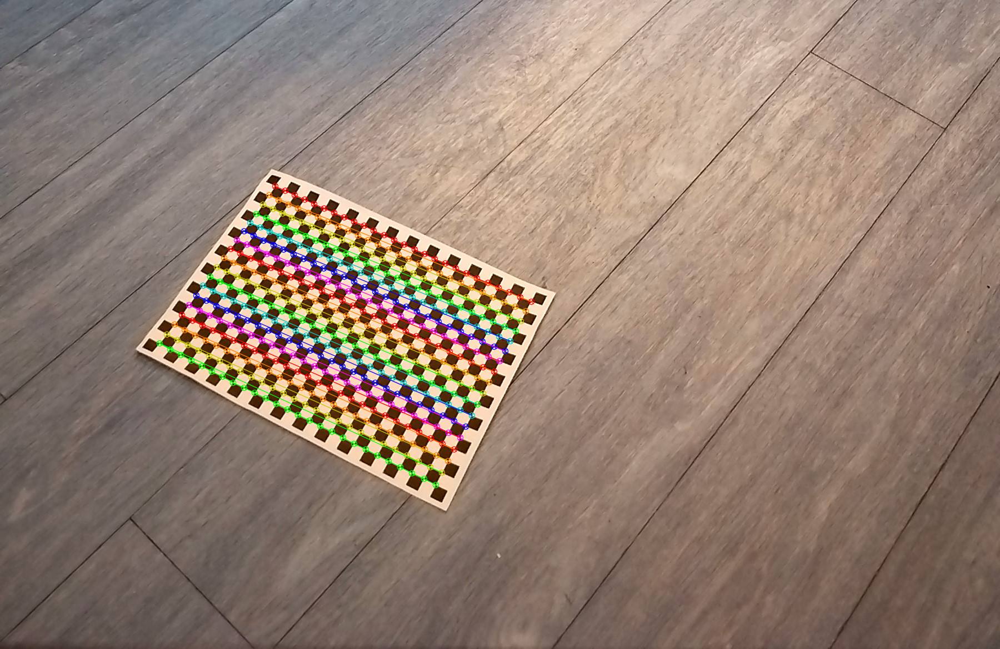

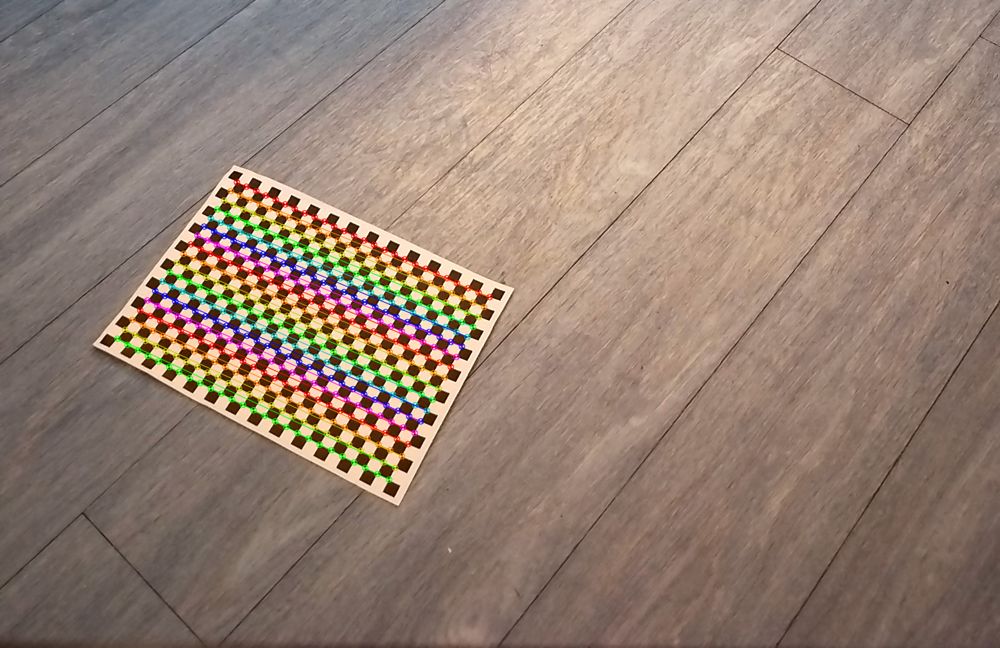

 25%|██▌       | 5/20 [00:11<00:34,  2.32s/it]

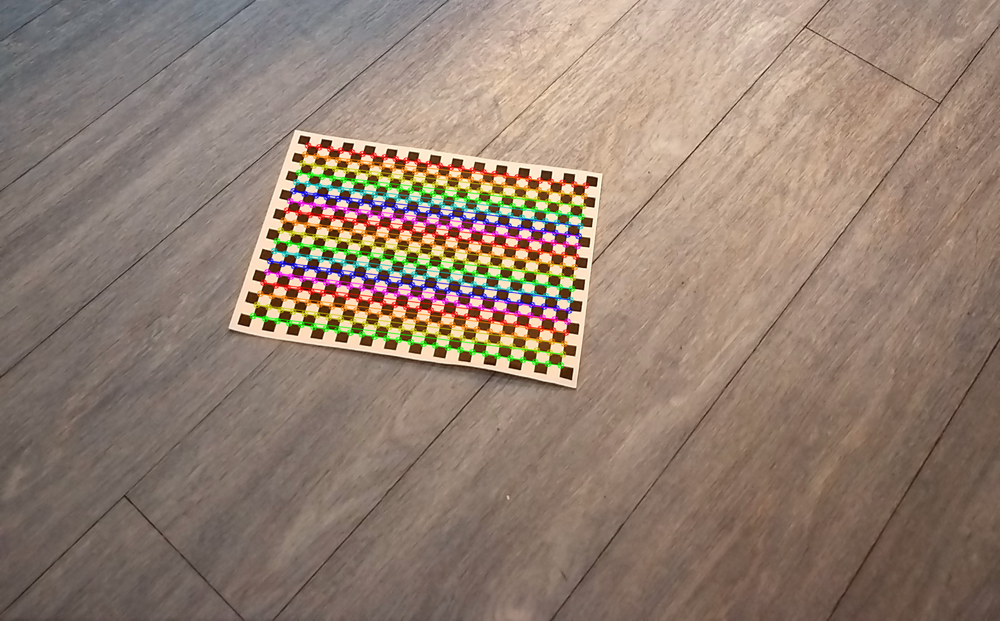

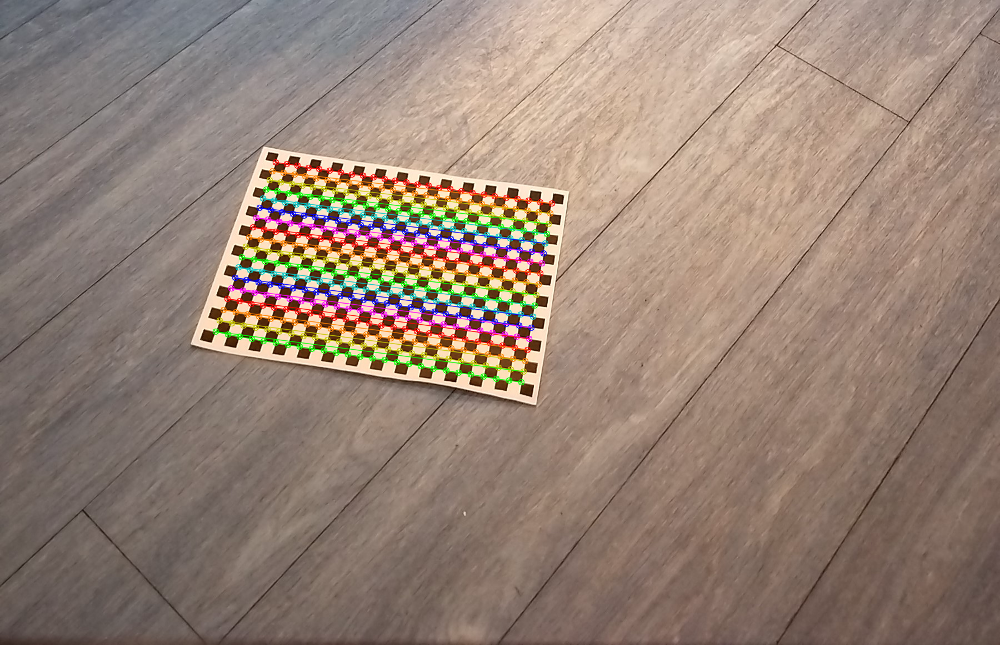

 30%|███       | 6/20 [00:13<00:31,  2.25s/it]

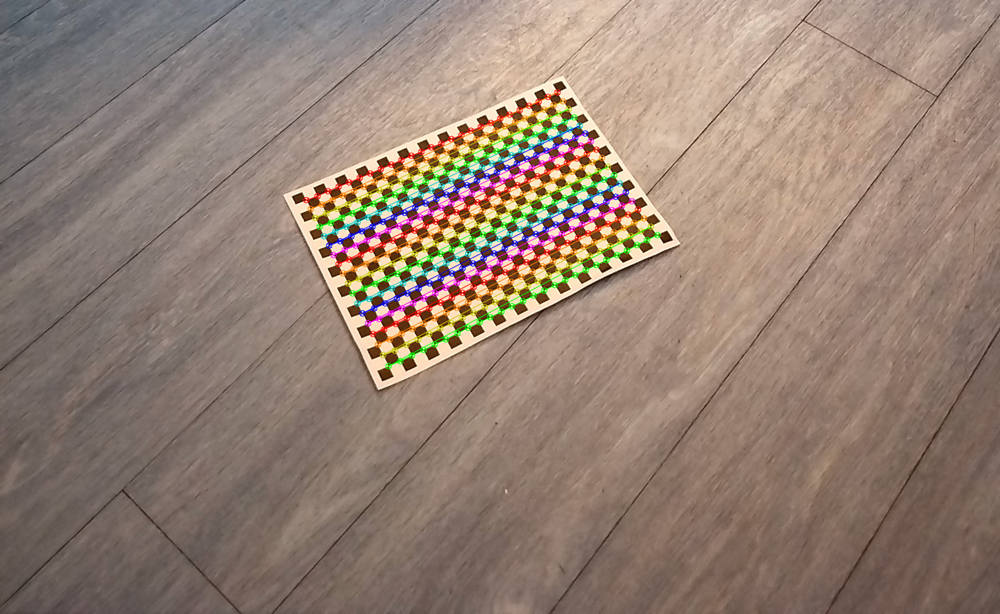

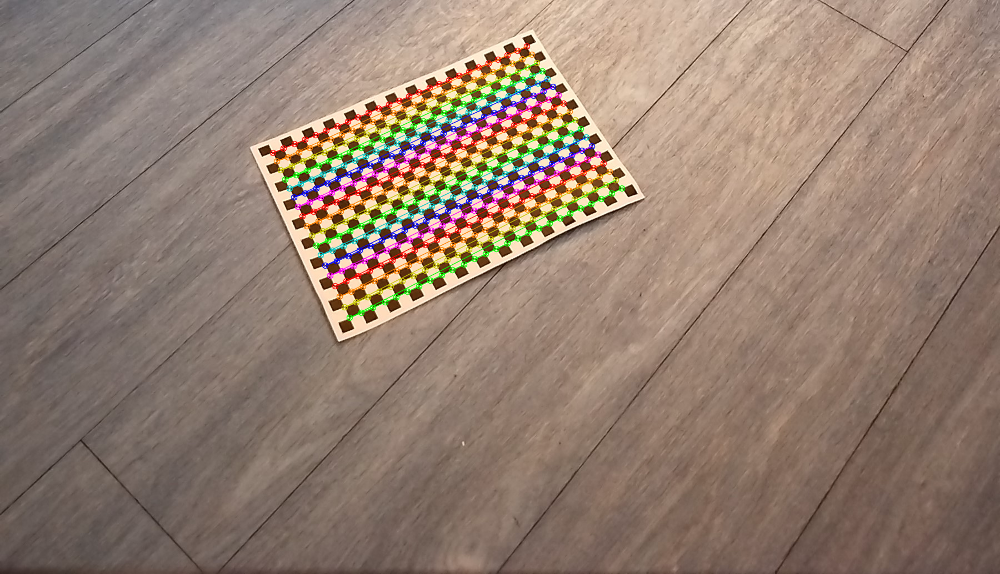

 35%|███▌      | 7/20 [00:15<00:28,  2.18s/it]

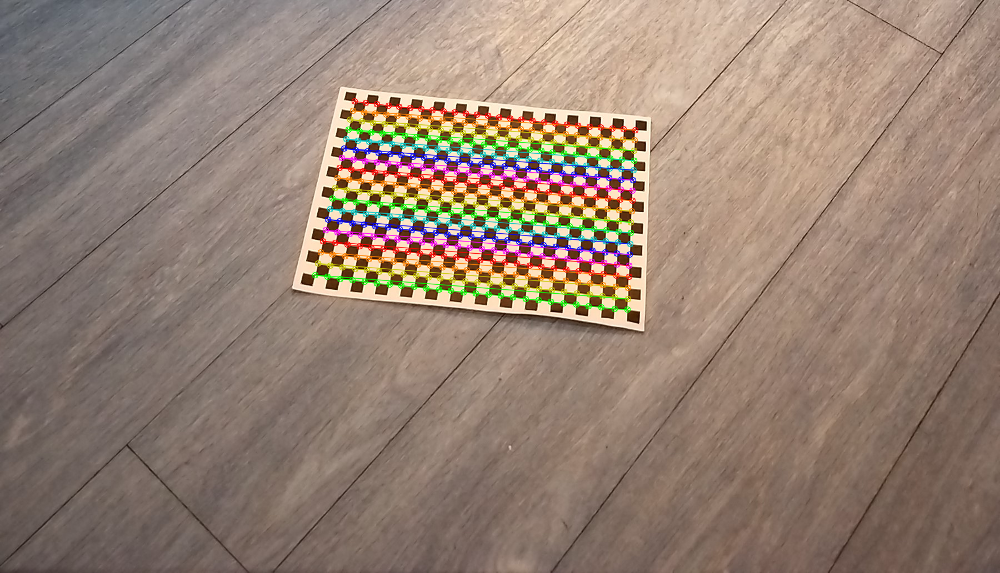

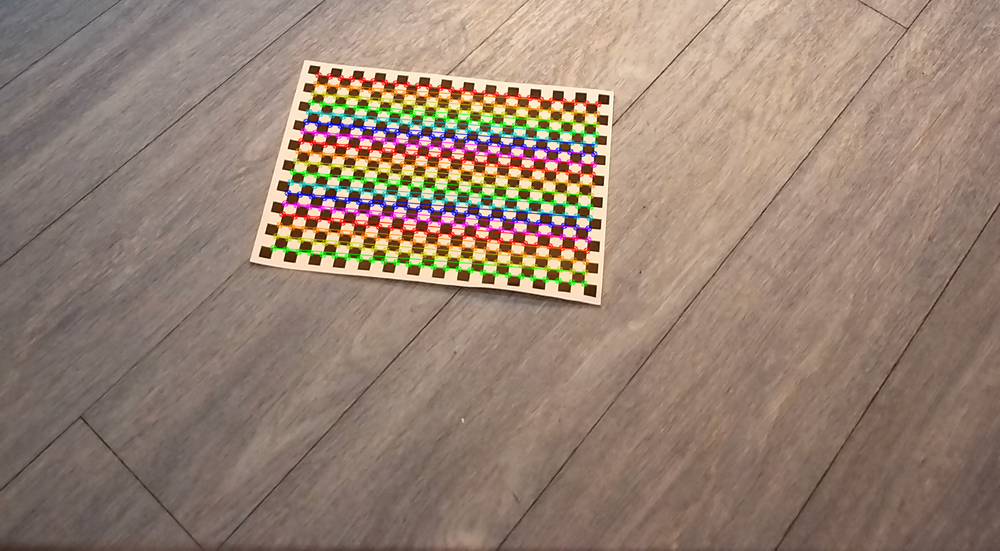

 40%|████      | 8/20 [00:17<00:25,  2.14s/it]

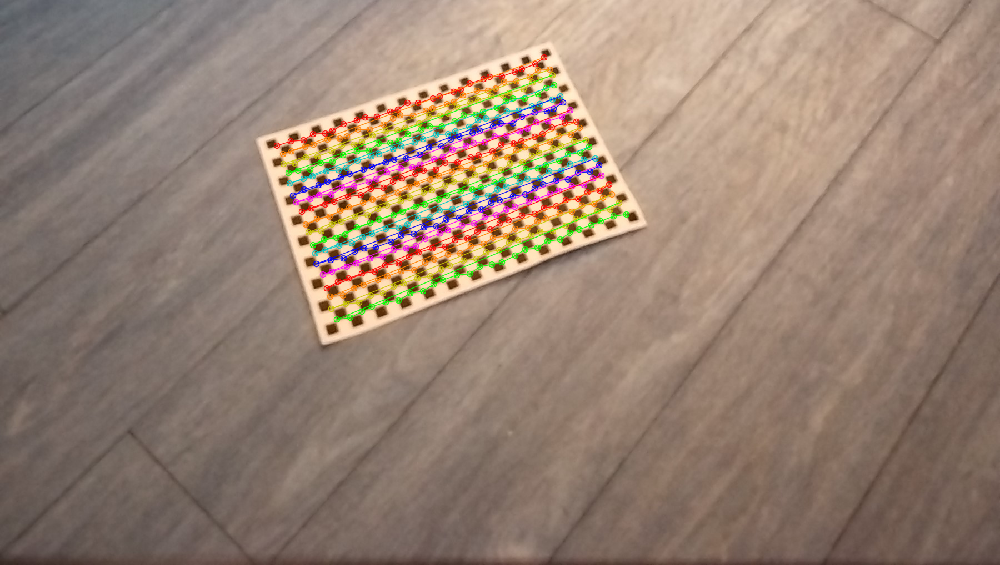

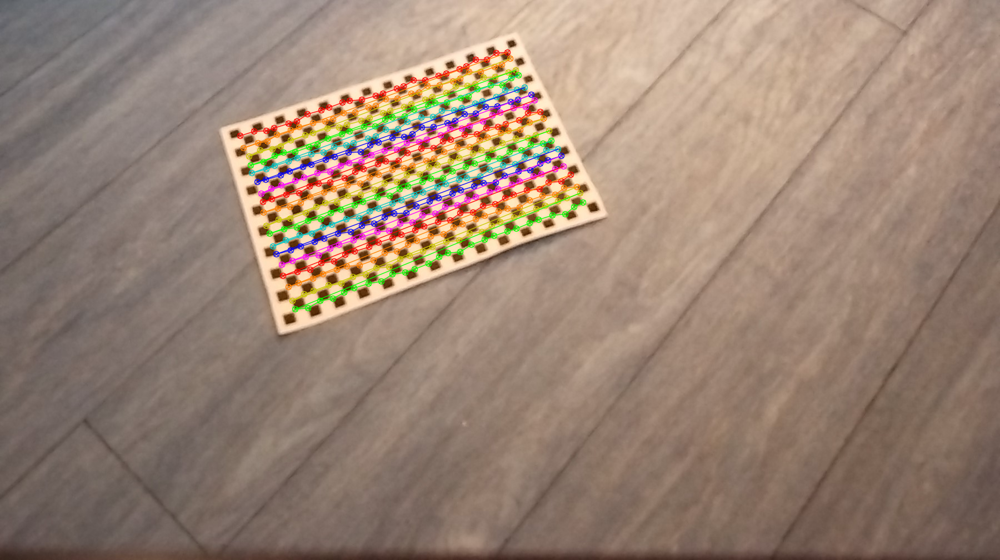

 45%|████▌     | 9/20 [00:20<00:27,  2.50s/it]

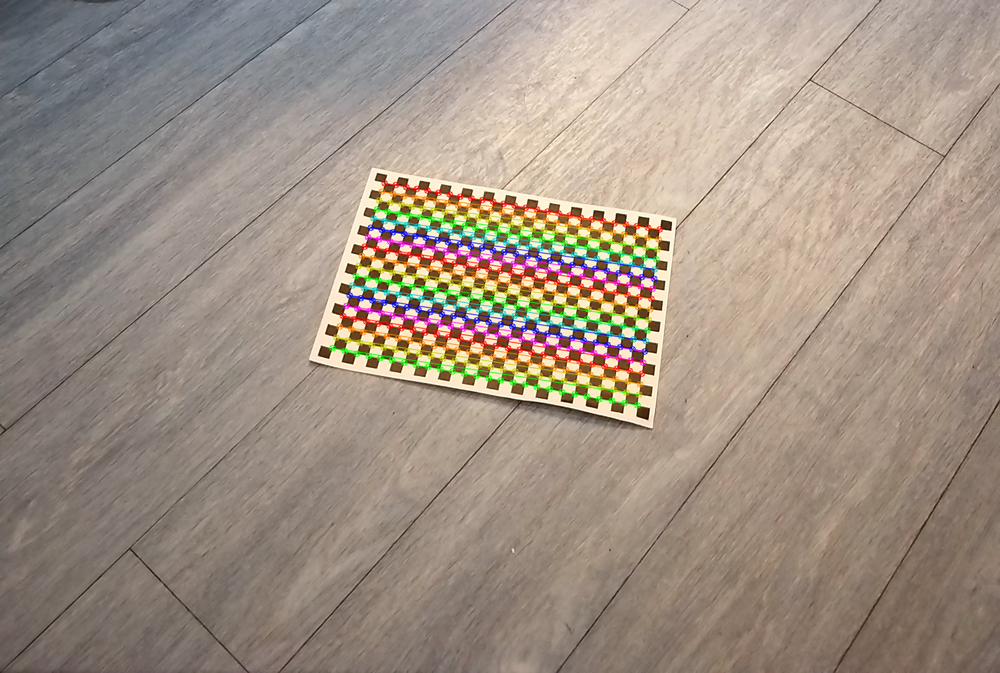

Buffered data was truncated after reaching the output size limit.

In [ ]:
#images captured by the left and right cameras
pathL = "L"
pathR = "R"
 
img_mask_L = "L/*.jpg"
img_mask_R = "R/*.jpg"




# Termination criteria for refining the detected corners
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
 
 
objp = np.zeros((9*6,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
 
img_ptsL = []
img_ptsR = []
obj_pts = []
 
for i in tqdm(range(1,21)):
  imgL = read_and_resize(pathL+f'/L{i}.jpg')
  imgR = read_and_resize(pathR+f'/R{i}.jpg')
  imgL_gray = cv2.imread(pathL+f'/L{i}.jpg',0)
  imgR_gray = cv2.imread(pathR+f'/R{i}.jpg',0)
  # cv2_imshow(imgR_gray)
  outputL = imgL.copy()
  outputR = imgR.copy()
 
  retR, cornersR =  cv2.findChessboardCorners(outputR,(26,18),None)
  retL, cornersL = cv2.findChessboardCorners(outputL,(26,18),None)
 
  if (not retR) or (not retL):
      print("chessboard not found")
      continue

  if retR and retL:
    obj_pts.append(objp)
        # refining pixel coordinates for given 2d points.
    # corners2 = cv2.cornerSubPix(img, corners, (5,5),(-1,-1), criteria)
    cv2.cornerSubPix(imgR_gray,cornersR,(5,5),(-1,-1),criteria)
    cv2.cornerSubPix(imgL_gray,cornersL,(5,5),(-1,-1),criteria)
    cv2.drawChessboardCorners(outputR,(26,18),cornersR,retR)
    cv2.drawChessboardCorners(outputL,(26,18),cornersL,retL)
    cv2_imshow(outputR)
    cv2_imshow(outputL)
    # cv2.waitKey(0)
 
    img_ptsL.append(cornersL)
    img_ptsR.append(cornersR)
    obj_points.append(pattern_points)


 

In [ ]:
retL, mtxL, distL, rvecsL, tvecsL = cv2.calibrateCamera(obj_points,img_ptsL,imgL_gray.shape[::-1],None,None)
hL,wL= imgL_gray.shape[:2]
new_mtxL, roiL= cv2.getOptimalNewCameraMatrix(mtxL,distL,(wL,hL),1,(wL,hL))


print("\nRMS:", retL)
print("camera matrix:\n", mtxL)
print("distortion coefficients: ", distL.ravel())


# Calibrating right camera
retR, mtxR, distR, rvecsR, tvecsR = cv2.calibrateCamera(obj_points,img_ptsR,imgR_gray.shape[::-1],None,None)
hR,wR= imgR_gray.shape[:2]
new_mtxR, roiR= cv2.getOptimalNewCameraMatrix(mtxR,distR,(wR,hR),1,(wR,hR))

print("\nRMS:", retR)
print("camera matrix:\n", mtxR)
print("distortion coefficients: ", distR.ravel())



RMS: 1.986087892091285
camera matrix:
 [[2.97578634e+03 0.00000000e+00 9.77057442e+02]
 [0.00000000e+00 6.84767229e+03 5.80763885e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
distortion coefficients:  [ 3.30471883e-01 -5.45062804e+00 -5.69151101e-03  1.90465519e-02
  4.58195146e+01]

RMS: 1.9475959235430582
camera matrix:
 [[3.01224448e+03 0.00000000e+00 9.69915648e+02]
 [0.00000000e+00 7.38767967e+03 5.72999194e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
distortion coefficients:  [ 2.41953549e-01 -3.44232680e+00 -6.99535308e-03  1.29243336e-02
  3.25284496e+01]


In [ ]:
flags = 0
flags |= cv2.CALIB_FIX_INTRINSIC
# Here we fix the intrinsic camara matrixes so that only Rot, Trns, Emat and Fmat are calculated.
# Hence intrinsic parameters are the same 
 
criteria_stereo= (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
 
 
# This step is performed to transformation between the two cameras and calculate Essential and Fundamenatl matrix
retS, new_mtxL, distL, new_mtxR, distR, Rot, Trns, Emat, Fmat = cv2.stereoCalibrate(obj_points, img_ptsL, img_ptsR, new_mtxL, distL, new_mtxR, distR, imgL_gray.shape[::-1], criteria_stereo, flags)


In [ ]:

rectify_scale= 1
rect_l, rect_r, proj_mat_l, proj_mat_r, Q, roiL, roiR= cv2.stereoRectify(new_mtxL, distL, new_mtxR, distR, imgL_gray.shape[::-1], Rot, Trns, rectify_scale,(0,0))


In [ ]:
Left_Stereo_Map= cv2.initUndistortRectifyMap(new_mtxL, distL, rect_l, proj_mat_l,
                                             imgL_gray.shape[::-1], cv2.CV_16SC2)
Right_Stereo_Map= cv2.initUndistortRectifyMap(new_mtxR, distR, rect_r, proj_mat_r,
                                              imgR_gray.shape[::-1], cv2.CV_16SC2)
 
print("Saving parameters ......")
cv_file = cv2.FileStorage("improved_params2.xml", cv2.FILE_STORAGE_WRITE)
cv_file.write("Left_Stereo_Map_x",Left_Stereo_Map[0])
cv_file.write("Left_Stereo_Map_y",Left_Stereo_Map[1])
cv_file.write("Right_Stereo_Map_x",Right_Stereo_Map[0])
cv_file.write("Right_Stereo_Map_y",Right_Stereo_Map[1])
cv_file.release()

Saving parameters ......


##Distance Calculations: 

In [4]:
import sys
import cv2
import numpy as np
import time


def find_depth(right_point, left_point, frame_right, frame_left, baseline,f, alpha):

    # CONVERT FOCAL LENGTH f FROM [mm] TO [pixel]:
    height_right, width_right, depth_right = frame_right.shape
    height_left, width_left, depth_left = frame_left.shape

    if width_right == width_left:
        f_pixel = (width_right * 0.5) / np.tan(alpha * 0.5 * np.pi/180)

    else:
        print('Left and right camera frames do not have the same pixel width')

    x_right = right_point
    x_left = left_point

    # CALCULATE THE DISPARITY:
    disparity = x_left-x_right      #Displacement between left and right frames [pixels]

    # CALCULATE DEPTH z:
    zDepth =  18*(baseline*f_pixel)/disparity             #Depth in [cm]

    return zDepth



B = 8               #Distance between the cameras [cm]
f = 4              #Camera lense's focal length [mm]
alpha = 70        #Camera field of view in the horisontal plane [degrees]

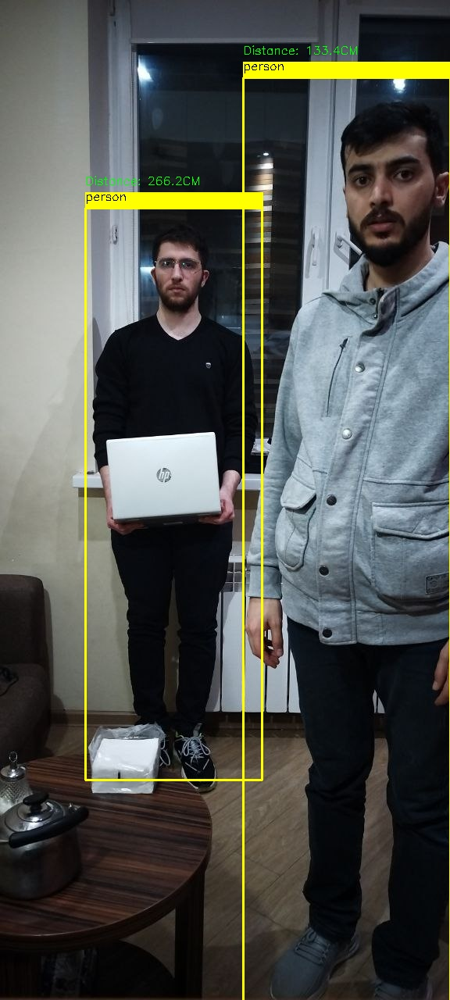

In [5]:
from google.colab.patches import cv2_imshow
import numpy as np
import cv2


def format_yolov5(frame):

    row, col, _ = frame.shape
    _max = max(col, row)
    result = np.zeros((_max, _max, 3), np.uint8)
    result[0:row, 0:col] = frame
    return result

# step 1 - load the model

net = cv2.dnn.readNet('yolov5s.onnx')

# step 2 - feed a 640x640 image to get predictions

image = cv2.imread('q.jpg')
input_image = format_yolov5(image) # making the image square
blob = cv2.dnn.blobFromImage(input_image , 1/255.0, (640, 640), swapRB=True)
net.setInput(blob)
predictions = net.forward()


class_ids = []
confidences = []
boxes = []

output_data = predictions[0]

image_width, image_height, _ = input_image.shape
x_factor = image_width / 640
y_factor =  image_height / 640

for r in range(25200):
    row = output_data[r]
    confidence = row[4]
    if confidence >= 0.4:

        classes_scores = row[5:]
        _, _, _, max_indx = cv2.minMaxLoc(classes_scores)
        class_id = max_indx[1]
        if (classes_scores[class_id] > .25):

            confidences.append(confidence)

            class_ids.append(class_id)

            x, y, w, h = row[0].item(), row[1].item(), row[2].item(), row[3].item() 
            left = int((x - 0.5 * w) * x_factor)
            top = int((y - 0.5 * h) * y_factor)
            width = int(w * x_factor)
            height = int(h * y_factor)
            box = np.array([left, top, width, height])
            boxes.append(box)

class_list = []
with open("classes.txt", "r") as f:
    class_list = [cname.strip() for cname in f.readlines()]

indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.25, 0.45) 

result_class_ids = []
result_confidences = []
result_boxes = []

for i in indexes:
    result_confidences.append(confidences[i])
    result_class_ids.append(class_ids[i])
    result_boxes.append(boxes[i])


for i in range(len(result_class_ids)):
    if result_class_ids[i]==0:
      box = result_boxes[i]
      class_id = result_class_ids[i]

      cv2.rectangle(image, box, (0, 255, 255), 2)
      cv2.rectangle(image, (box[0], box[1] - 20), (box[0] + box[2], box[1]), (0, 255, 255), -1)
      cv2.putText(image, class_list[class_id], (box[0], box[1] - 10), cv2.FONT_HERSHEY_SIMPLEX, .5, (0,0,0))

      center_point_right = 0
      center_point_left = (box[0] + box[2] / 2, box[1] + box[3] / 2)

      depth = find_depth(center_point_right, center_point_left[0], image, image, B, f, alpha)
      cv2.putText(image, "Distance: " + str(round(depth,1))+'CM', (box[0], box[1] - 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,255,0),1)
    
      cv2.imwrite("text%d.jpg"%i, image)
      img=cv2.imread("text%d.jpg"%i)   


cv2_imshow(img)